In [26]:
% matplotlib inline
% load_ext autoreload
% autoreload 2
import h5py
import numpy as np
import re
import gc
import os
from matplotlib import pyplot as plt
from matplotlib import ticker
import seaborn as sns
sns.set_style("whitegrid")

import os, sys
sys.path.append(os.path.join(os.path.dirname(os.getcwd()), "pore_utils"))
import pore_segmenter
from batch_segmentation_hmm_dask import *
import plot_captures
from pore_utils import raw_signal_utils
from pore_utils import peptide_segmentation as pepseg
from pore_utils.yaml_assistant import YAMLAssistant

sys.path.append(os.path.dirname(os.getcwd()))
import peptide_filter_utils as pepfilter
from NTER_CNN import *

import peptide_quantifier_utils as pepquant
import json

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load run configuration

In [2]:
date = "20190504"
flowcell = "FAK67809"
config_file = os.path.join(os.path.dirname(os.getcwd()), "configs/segment_%s_%s.yml" % (date, flowcell))

## Parse multi-experiment fast5 file

Splits bulk fast5 based on run partitions. Make sure to change temp file name if running multiple experiment notebooks in parallel so they will not overwrite each other!

In [3]:
raw_signal_utils.split_multi_fast5(config_file, temp_f5_fname="/disk1/pore_data/temp2.f5")

Preparing a template fast5 file for run01 splits.
Copying the template for each split and adding metadata.
Split: run01_a
Split: run01_b
Split: run01_c
Split: run01_d
Split: run01_e
Split: run01_f
Splitting fast5, processing one channel at a time.
    Channel_1
    Channel_2
    Channel_3
    Channel_4
    Channel_5
    Channel_6
    Channel_7
    Channel_8
    Channel_9
    Channel_10
    Channel_11
    Channel_12
    Channel_13
    Channel_14
    Channel_15
    Channel_16
    Channel_17
    Channel_18
    Channel_19
    Channel_20
    Channel_21
    Channel_22
    Channel_23
    Channel_24
    Channel_25
    Channel_26
    Channel_27
    Channel_28
    Channel_29
    Channel_30
    Channel_31
    Channel_32
    Channel_33
    Channel_34
    Channel_35
    Channel_36
    Channel_37
    Channel_38
    Channel_39
    Channel_40
    Channel_41
    Channel_42
    Channel_43
    Channel_44
    Channel_45
    Channel_46
    Channel_47
    Channel_48
    Channel_49
    Channel_50
    Channel

    Channel_505
    Channel_506
    Channel_507
    Channel_508
    Channel_509
    Channel_510
    Channel_511
    Channel_512
Closing and compressing files.
Backing up the config file to /ssd1/home/kz9/NanoporeTERs/configs/segment_20190504_FAK67809.backup.20190910-1000.yml
Saving new filenames to config file.
Done


In [4]:
y = YAMLAssistant(config_file)

## What's in these runs?

Plots example traces from each run partition.

In [5]:
plt.ioff()
show_plot_here = True
fast5_dir = y.get_variable("fast5:dir")
fast5_prefix = y.get_variable("fast5:prefix")
fast5_fnames = y.get_variable("fast5:names")

run01_a.Channel_1


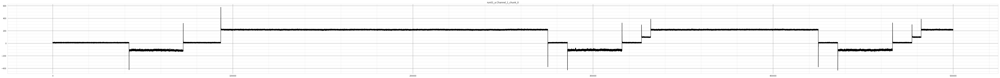

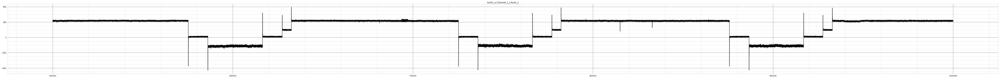

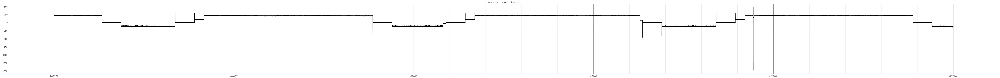

run01_a.Channel_2


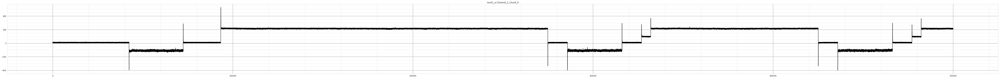

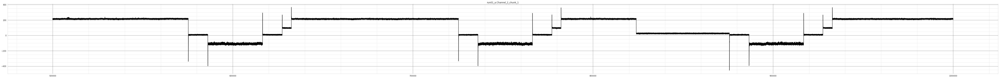

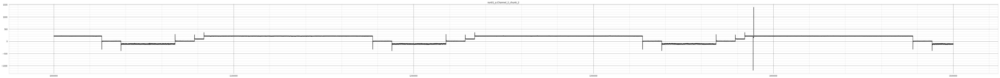

run01_a.Channel_3


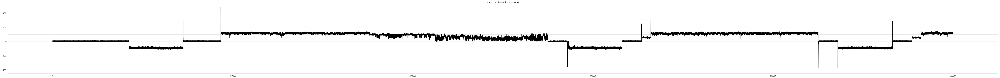

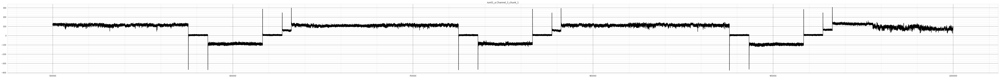

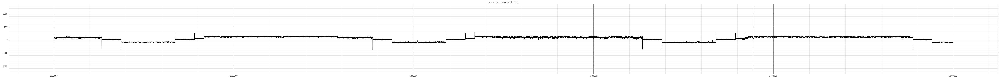

run01_a.Channel_4


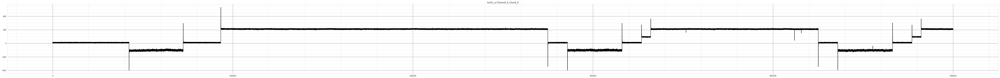

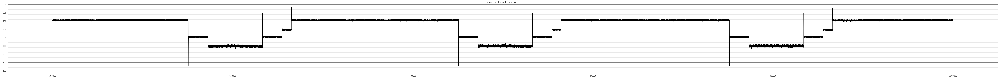

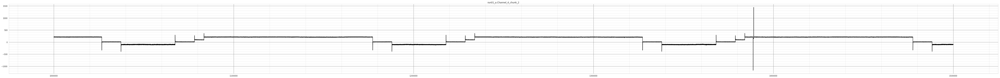

run01_a.Channel_5


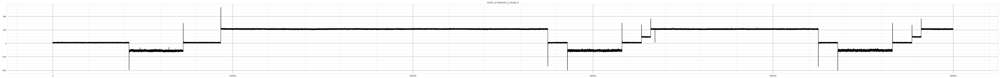

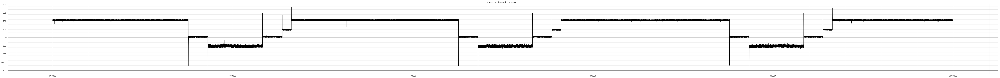

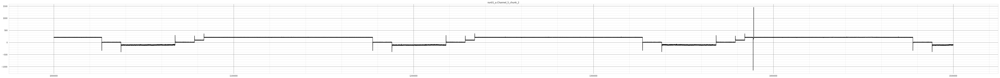

run01_a.Channel_6


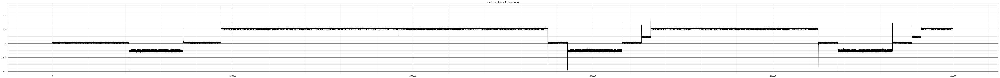

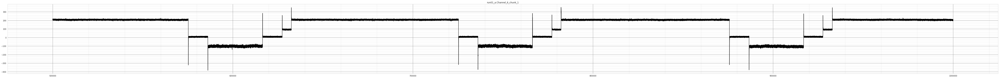

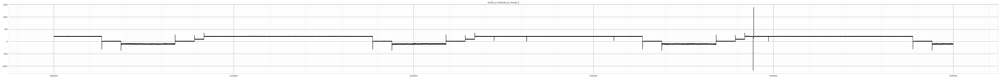

run01_a.Channel_7


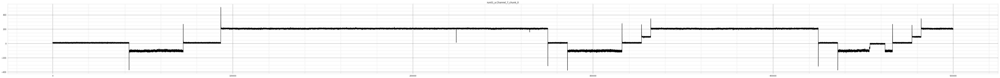

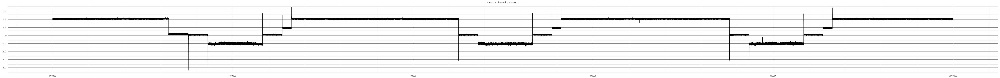

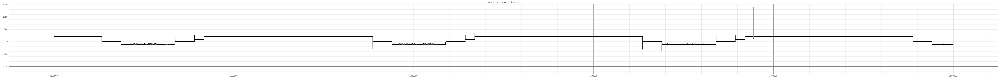

run01_a.Channel_8


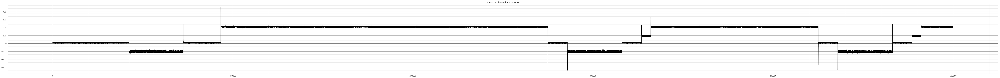

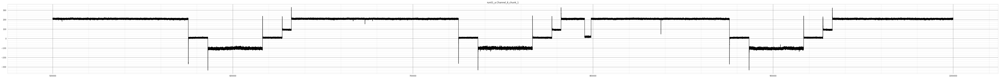

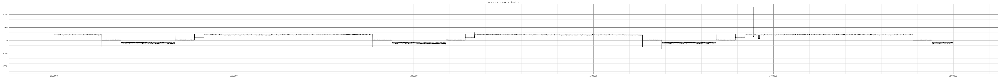

run01_a.Channel_9


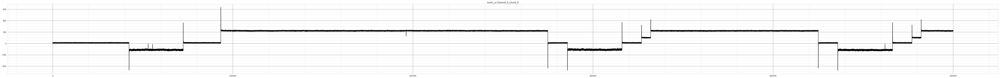

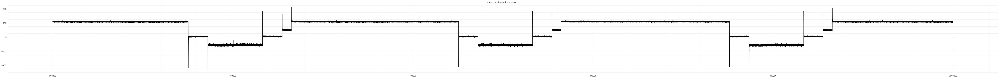

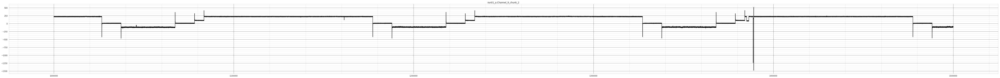

run01_a.Channel_10


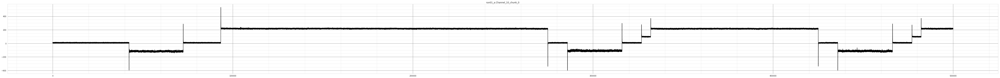

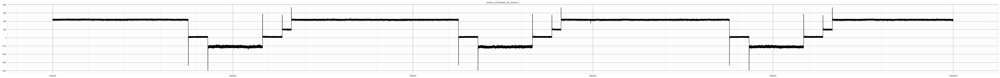

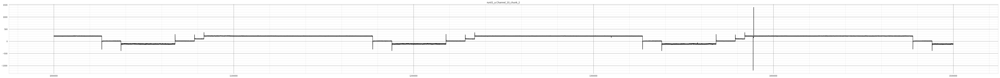

run01_b.Channel_1


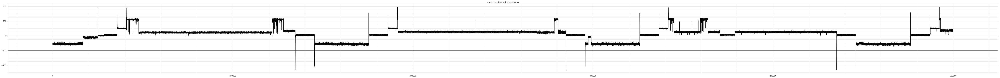

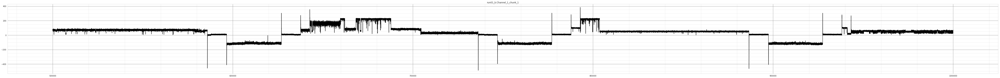

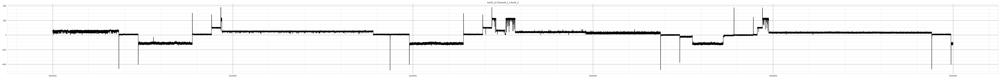

run01_b.Channel_2


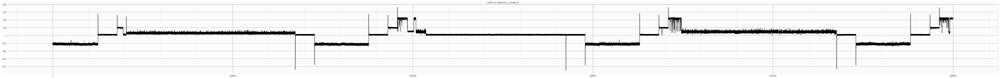

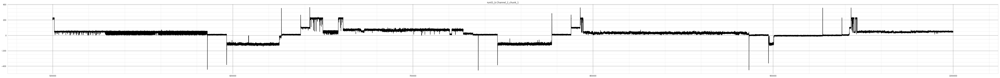

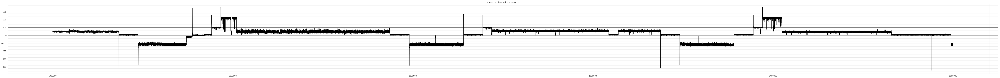

run01_b.Channel_3
run01_b.Channel_4


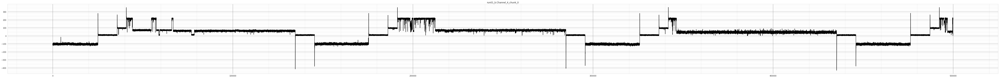

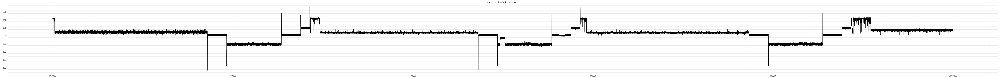

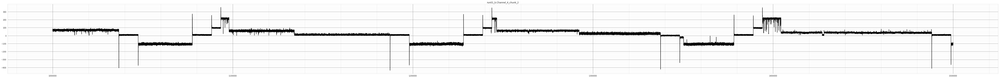

run01_b.Channel_5


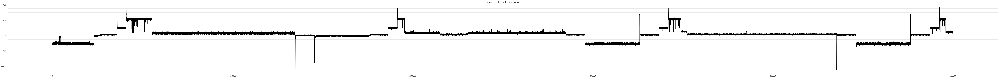

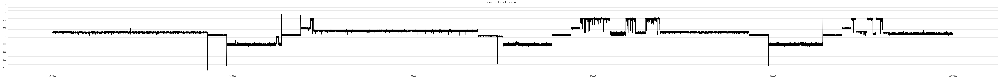

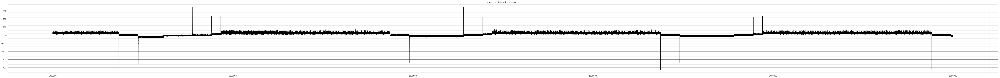

run01_b.Channel_6
run01_b.Channel_7


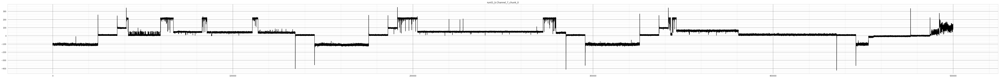

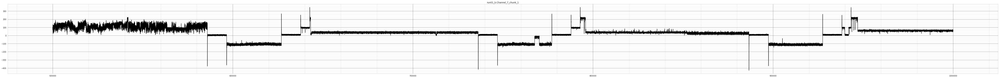

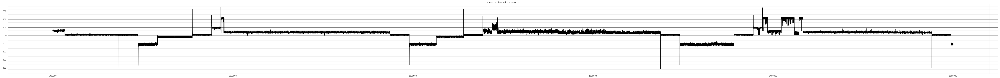

run01_b.Channel_8


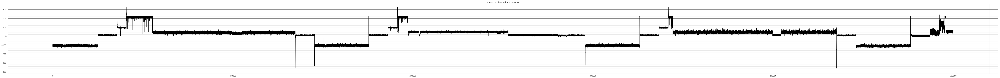

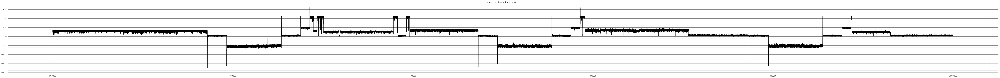

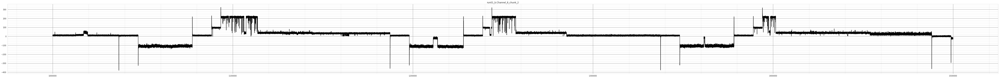

run01_b.Channel_9


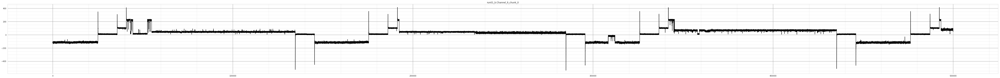

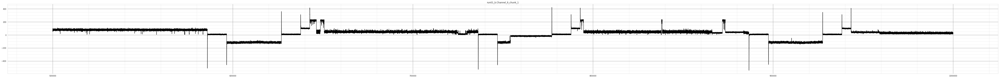

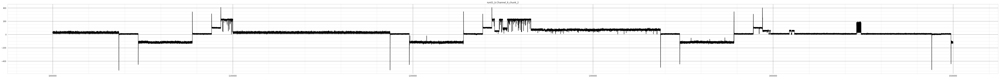

run01_b.Channel_10


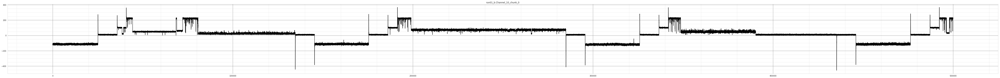

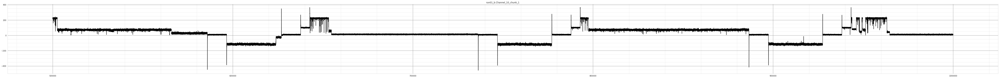

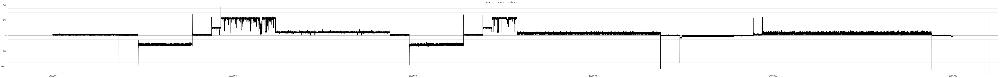

run01_c.Channel_1


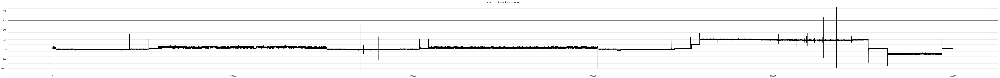

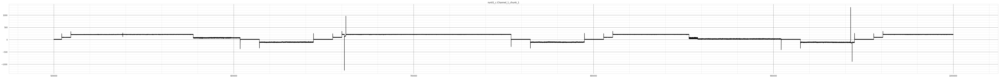

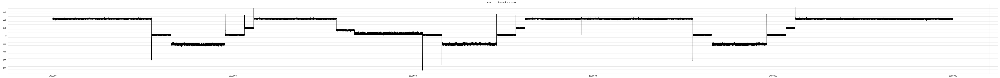

run01_c.Channel_2


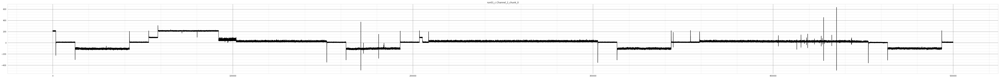

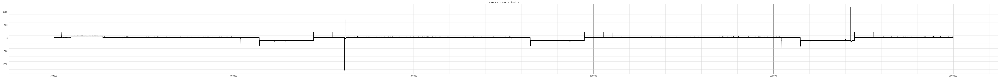

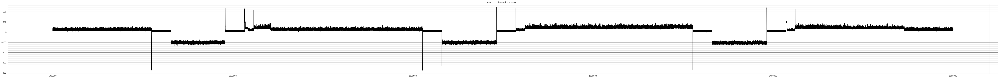

run01_c.Channel_3


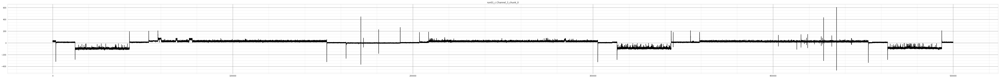

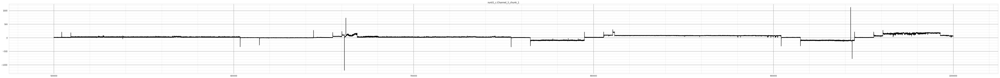

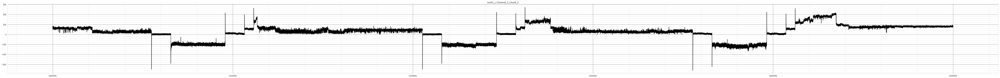

run01_c.Channel_4


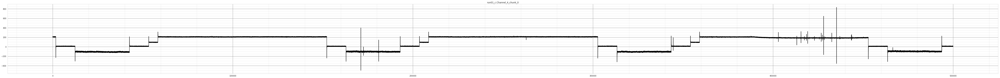

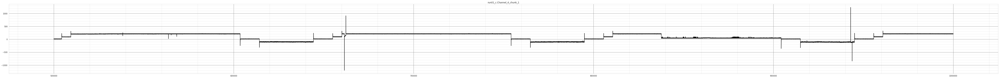

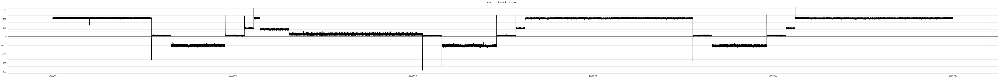

run01_c.Channel_5


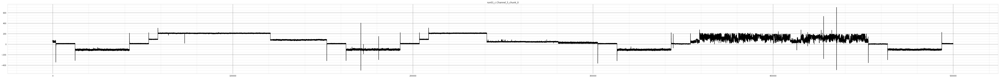

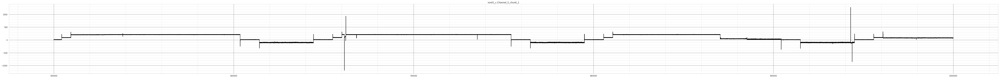

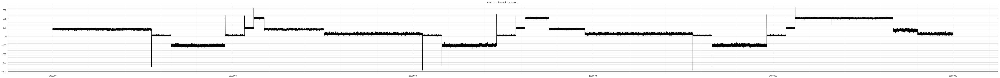

run01_c.Channel_6


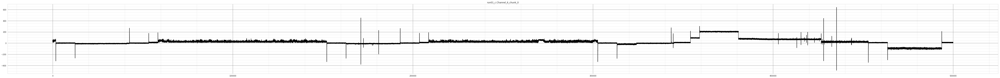

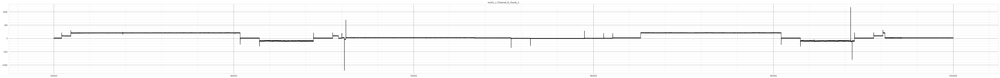

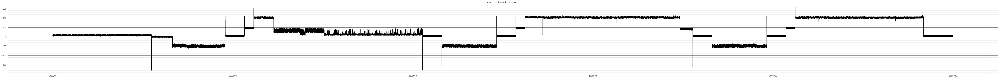

run01_c.Channel_7


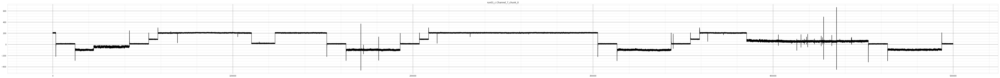

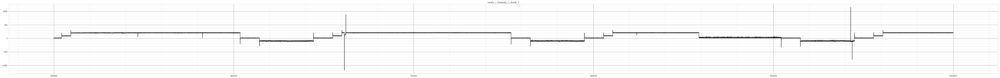

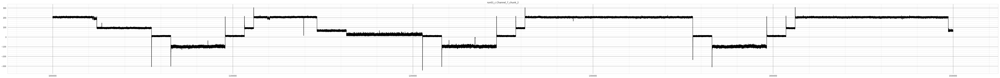

run01_c.Channel_8


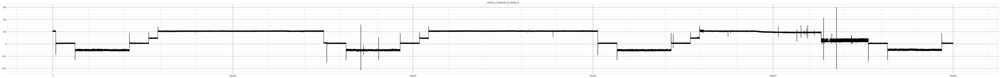

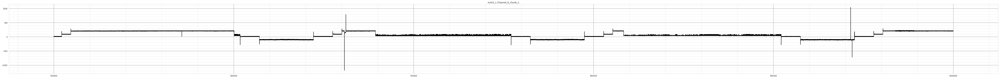

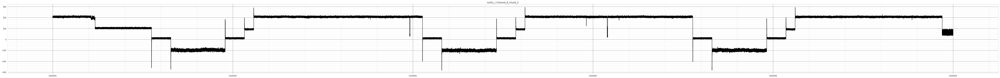

run01_c.Channel_9


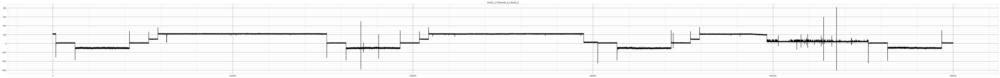

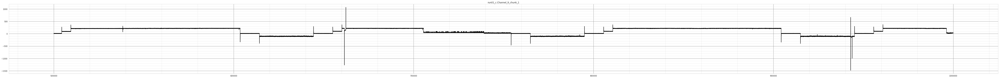

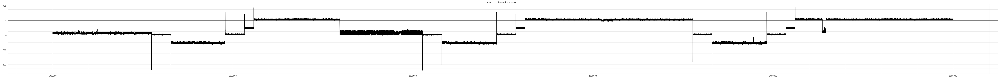

run01_c.Channel_10


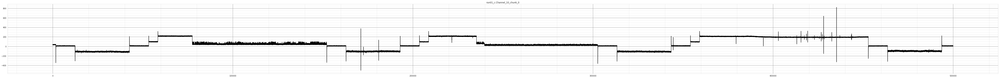

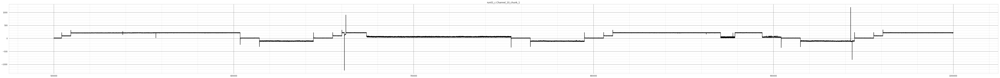

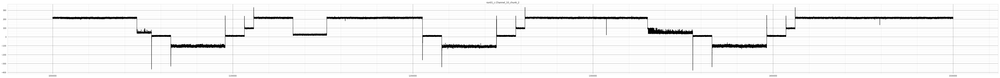

run01_d.Channel_1
run01_d.Channel_2


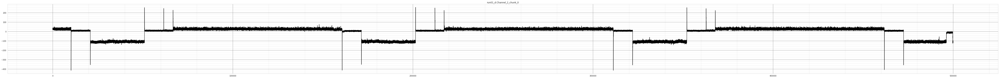

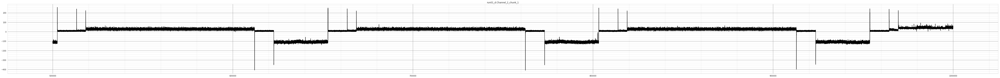

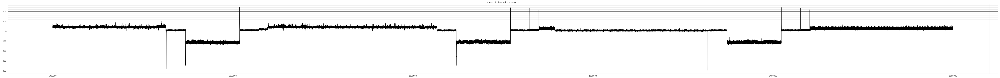

run01_d.Channel_3


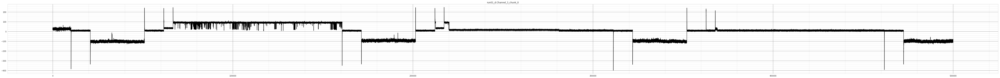

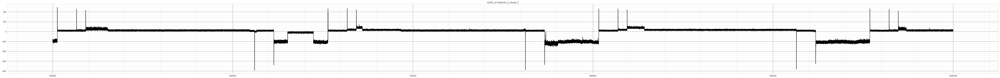

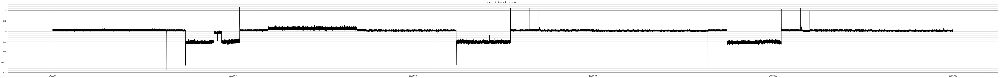

run01_d.Channel_4


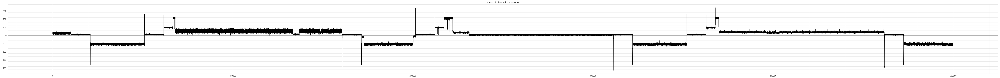

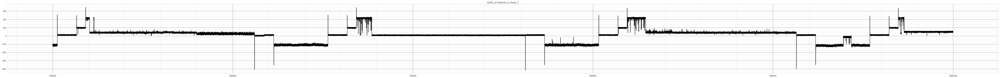

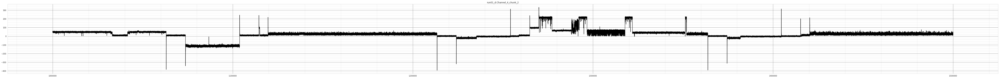

run01_d.Channel_5


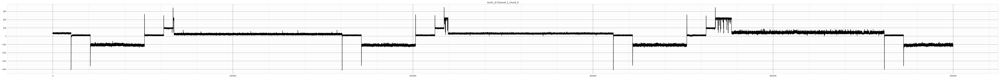

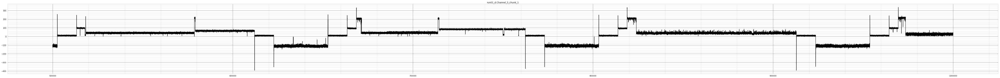

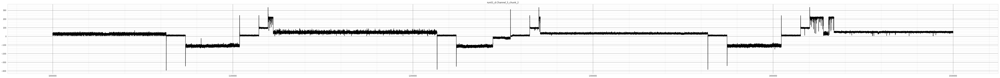

run01_d.Channel_6


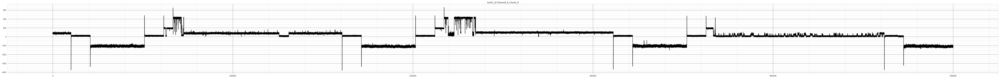

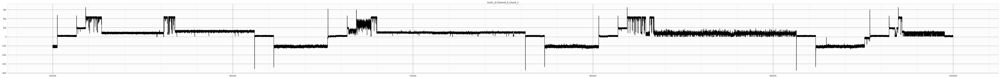

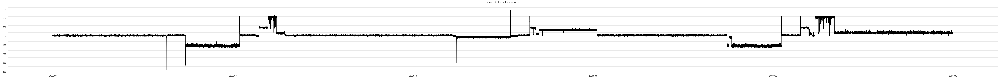

run01_d.Channel_7


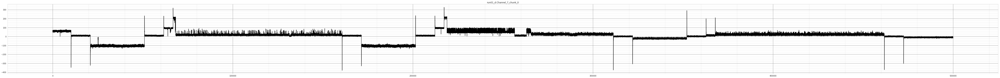

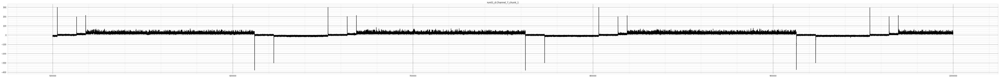

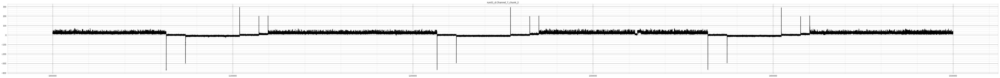

run01_d.Channel_8


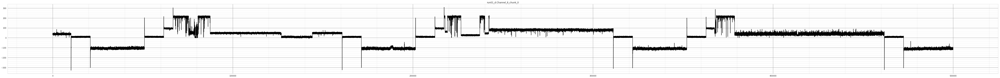

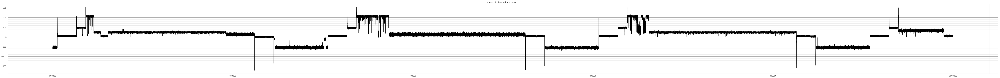

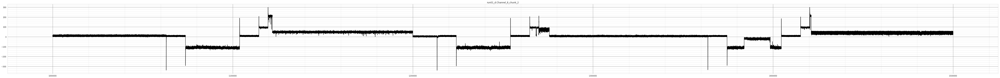

run01_d.Channel_9


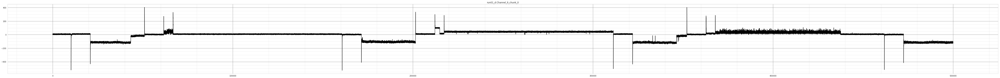

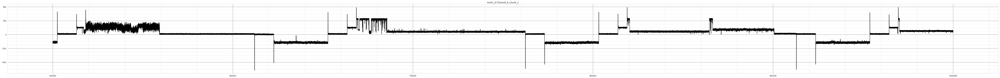

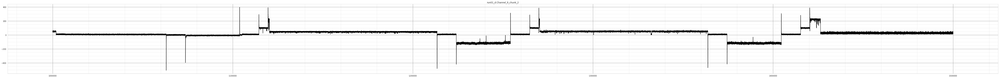

run01_d.Channel_10


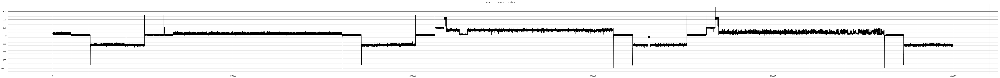

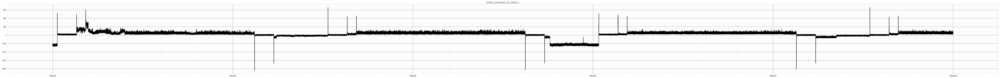

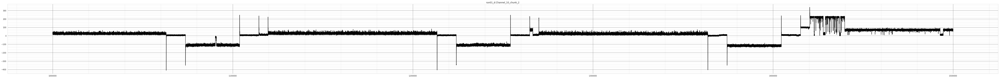

run01_e.Channel_1
run01_e.Channel_2


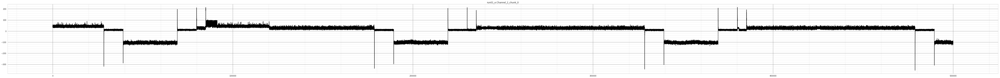

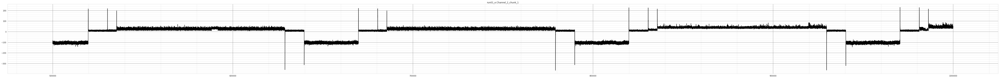

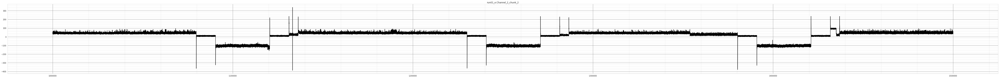

run01_e.Channel_3


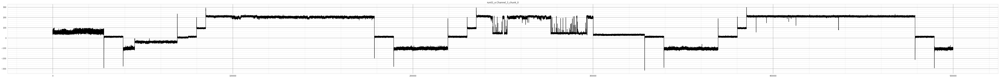

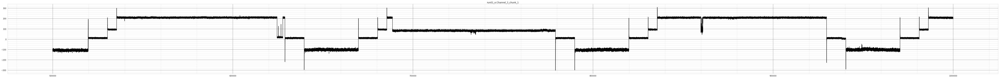

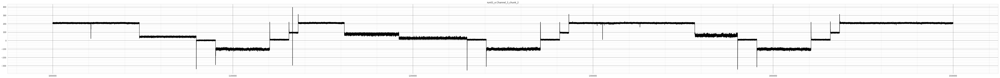

run01_e.Channel_4


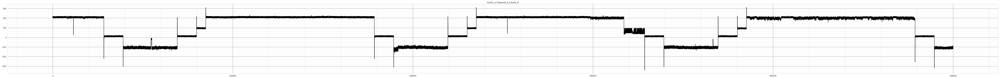

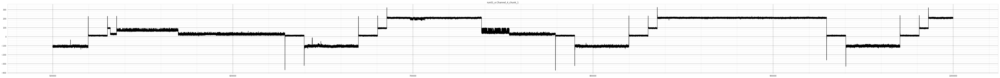

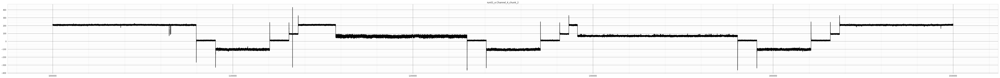

run01_e.Channel_5


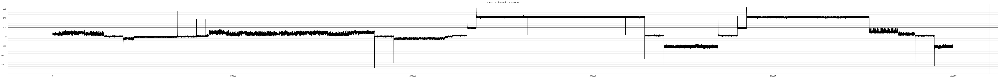

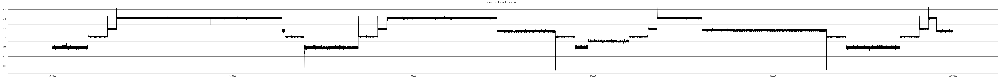

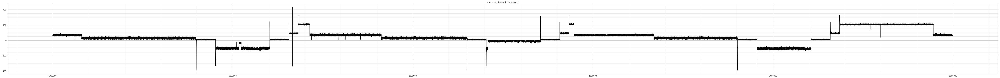

run01_e.Channel_6


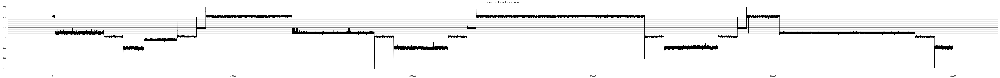

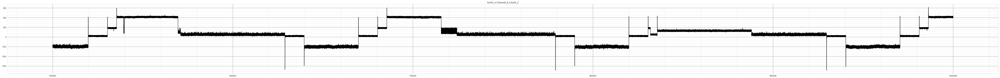

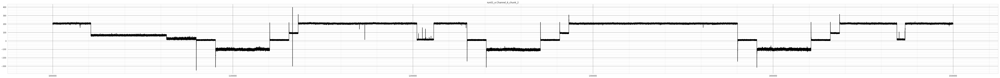

run01_e.Channel_7


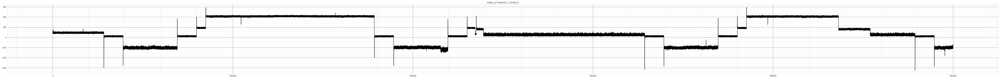

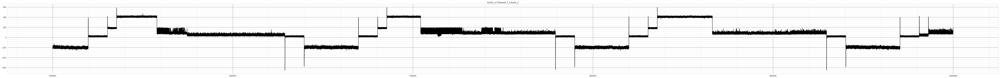

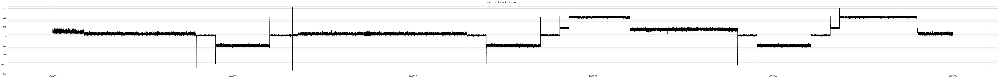

run01_e.Channel_8


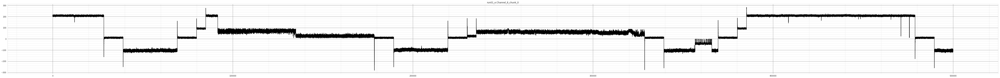

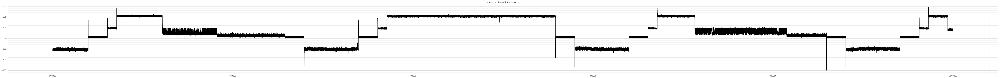

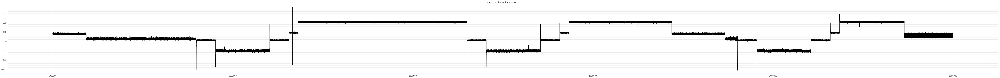

run01_e.Channel_9
run01_e.Channel_10


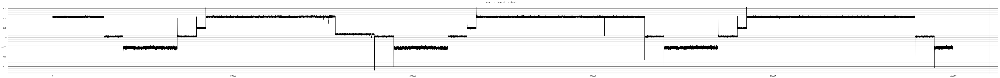

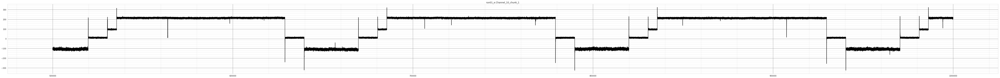

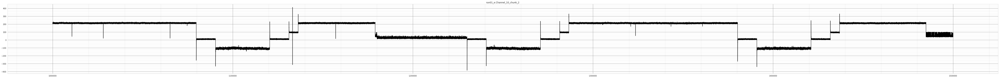

run01_f.Channel_1
run01_f.Channel_2


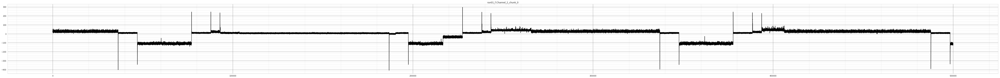

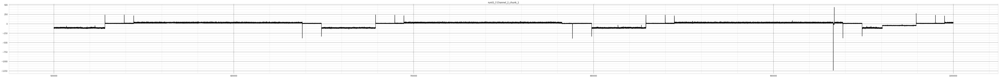

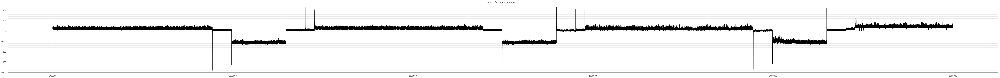

run01_f.Channel_3


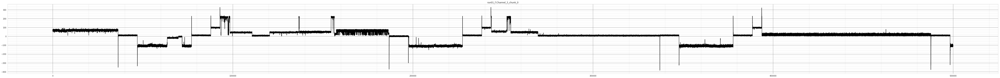

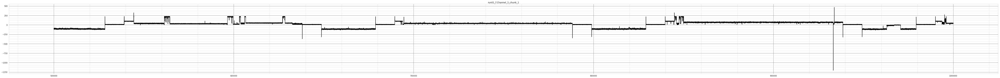

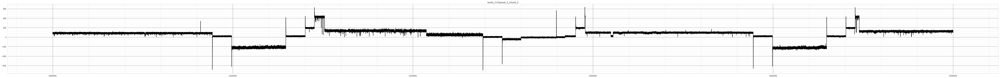

run01_f.Channel_4


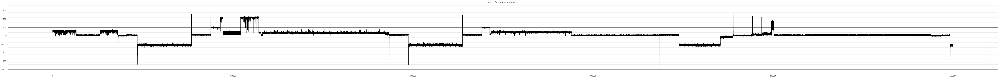

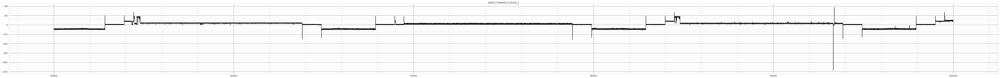

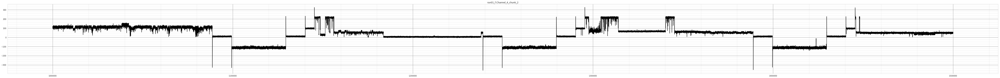

run01_f.Channel_5


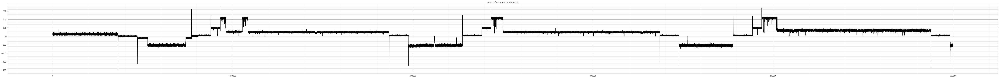

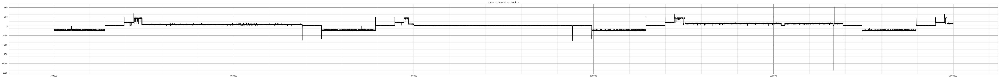

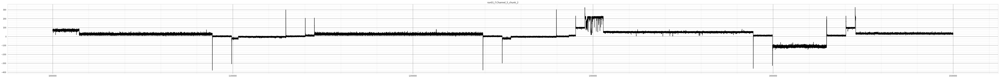

run01_f.Channel_6


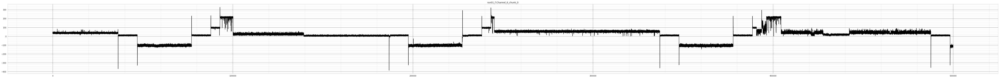

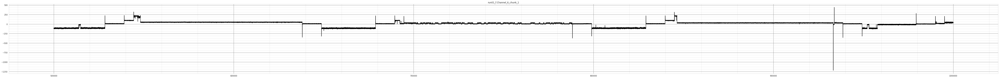

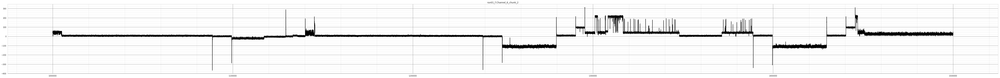

run01_f.Channel_7


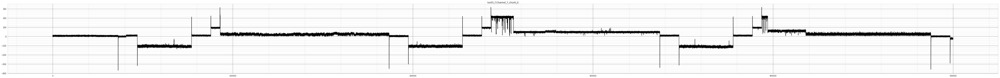

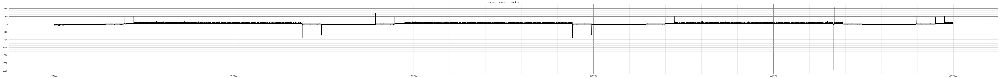

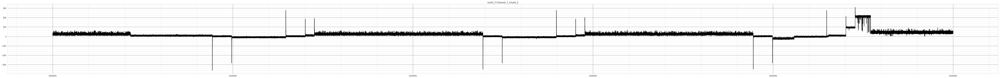

run01_f.Channel_8


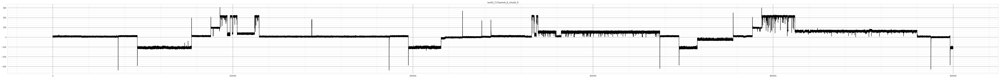

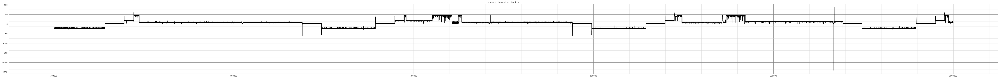

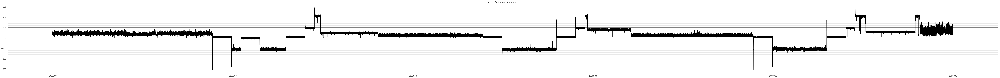

run01_f.Channel_9
run01_f.Channel_10


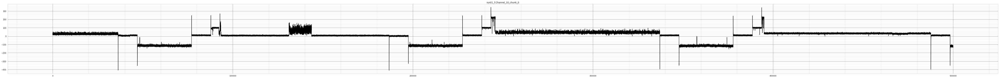

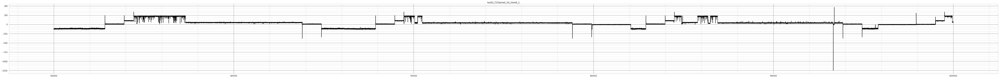

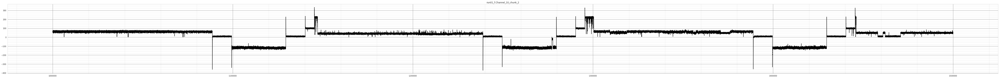

In [6]:
try:
    os.makedirs("../plots/%s/raw" % date)
except:
    pass

for run, fast5_fname in sorted(fast5_fnames.iteritems()):
    f5 = h5py.File(os.path.join(fast5_dir, fast5_prefix + fast5_fname))
    channels_present = [int(re.findall(r"Channel_(\d+)", str(x))[0])
                        for x in f5.get("/Raw").values()]
    for channel_no in sorted(channels_present)[:10]:
        channel = "Channel_%s" % str(channel_no)
        signal = raw_signal_utils.get_scaled_raw_for_channel(
            f5, channel=channel)
        source = run + "." + channel
        print source
        if np.std(signal) < 50:
            continue

        for chunk_i, chunk_start in enumerate(range(0, len(signal), 500000)[:3]):
            chunk_end = np.min([len(signal), chunk_start + 500000])
            fig, ax = plt.subplots(figsize=(75, 6))
            ax.plot(range(chunk_start, chunk_end),
                    signal[chunk_start:chunk_end], color="black")
            ax.set_title(source + "_chunk_%d" % chunk_i)
            ax.get_xaxis().set_minor_locator(ticker.AutoMinorLocator())
            ax.get_yaxis().set_minor_locator(ticker.AutoMinorLocator())
            ax.grid(b=True, which='major', color='grey', linewidth=1.0)
            ax.grid(b=True, which='minor', color='lightgrey', linewidth=0.5)
            fig.tight_layout()
            if show_plot_here:
                plt.show()
            try:
                fig.savefig("../plots/%s/raw/%s_%s_%s_chunk_%d.png" %
                            (date, date, run, channel, chunk_i))
            except OverflowError:
                pass
            fig.clf()
            plt.close()
            gc.collect()
plt.ion()

# Find good channels

Writes good channels to config file.

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_a.fast5
Finding good channels in run01_a.
Writing good channels to yaml file.
Plotting channel status.


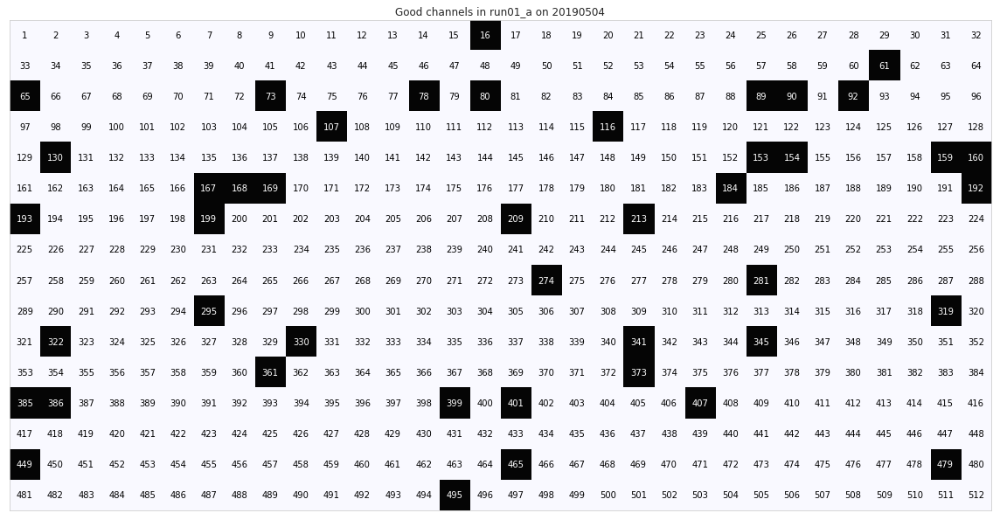

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_b.fast5
Finding good channels in run01_b.
Writing good channels to yaml file.
Plotting channel status.


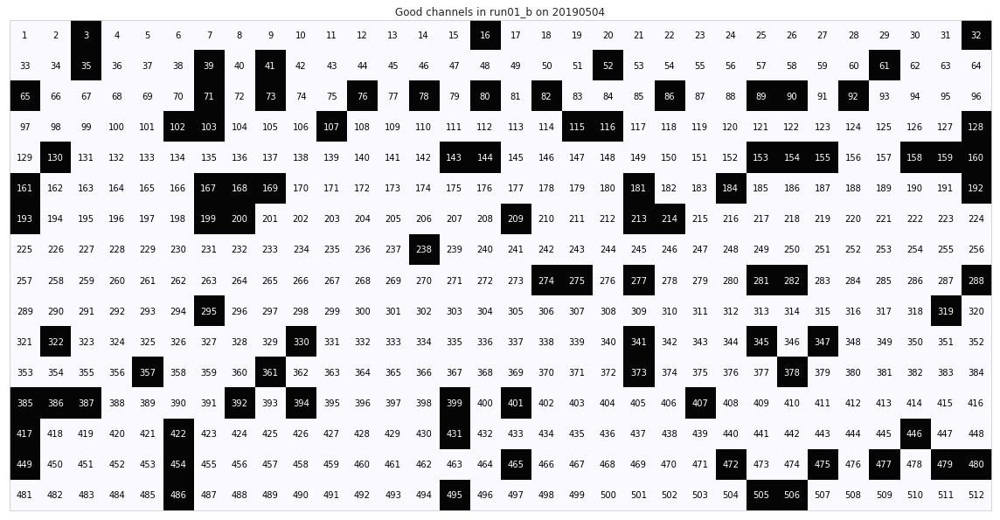

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_c.fast5
Finding good channels in run01_c.
Writing good channels to yaml file.
Plotting channel status.


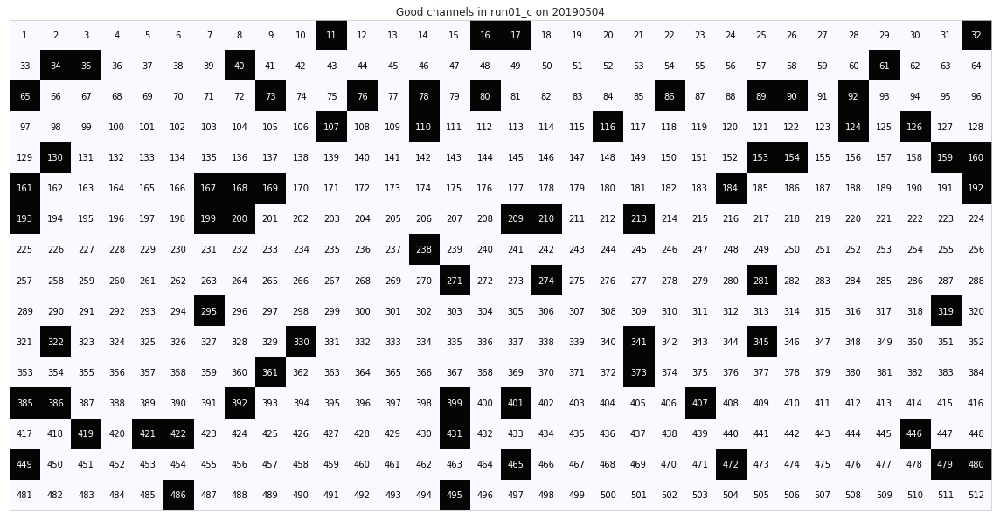

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_d.fast5
Finding good channels in run01_d.
Writing good channels to yaml file.
Plotting channel status.


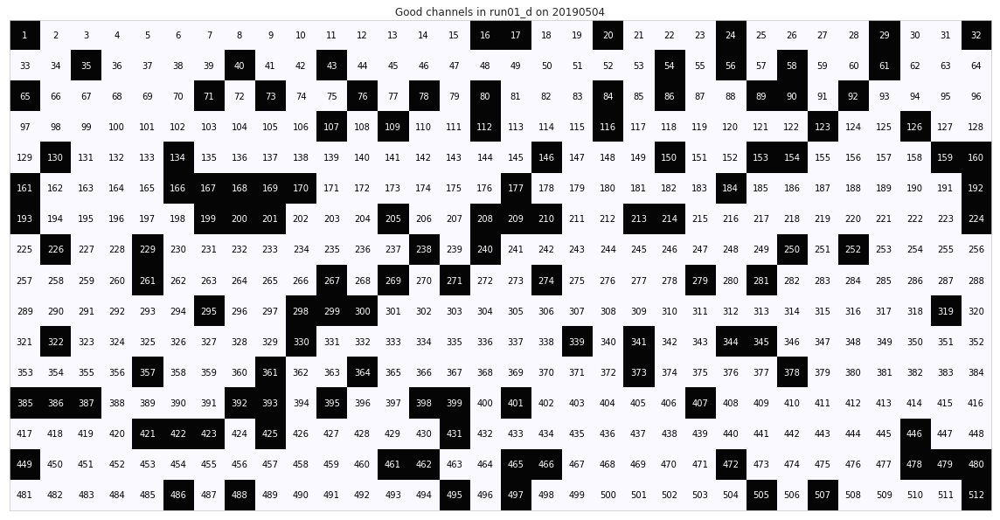

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_e.fast5
Finding good channels in run01_e.
Writing good channels to yaml file.
Plotting channel status.


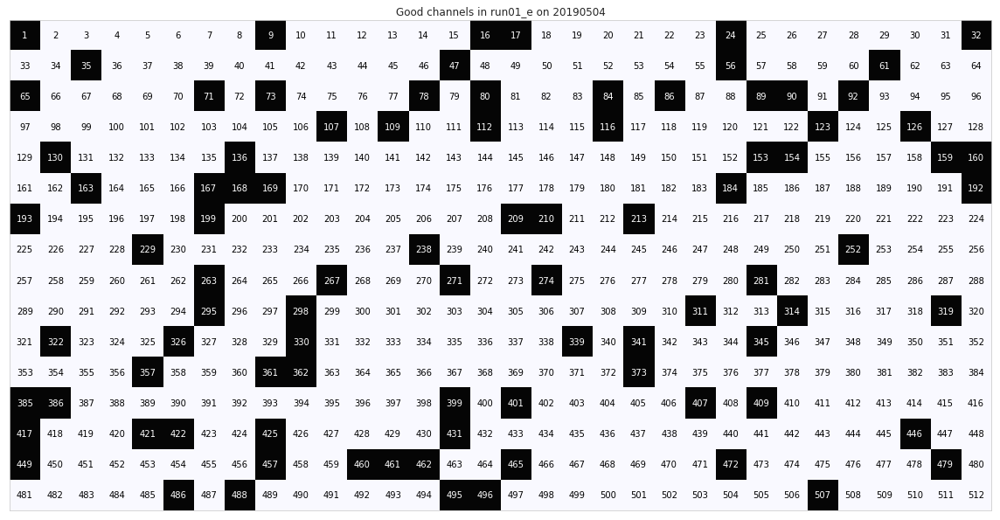

/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_f.fast5
Finding good channels in run01_f.
Writing good channels to yaml file.
Plotting channel status.


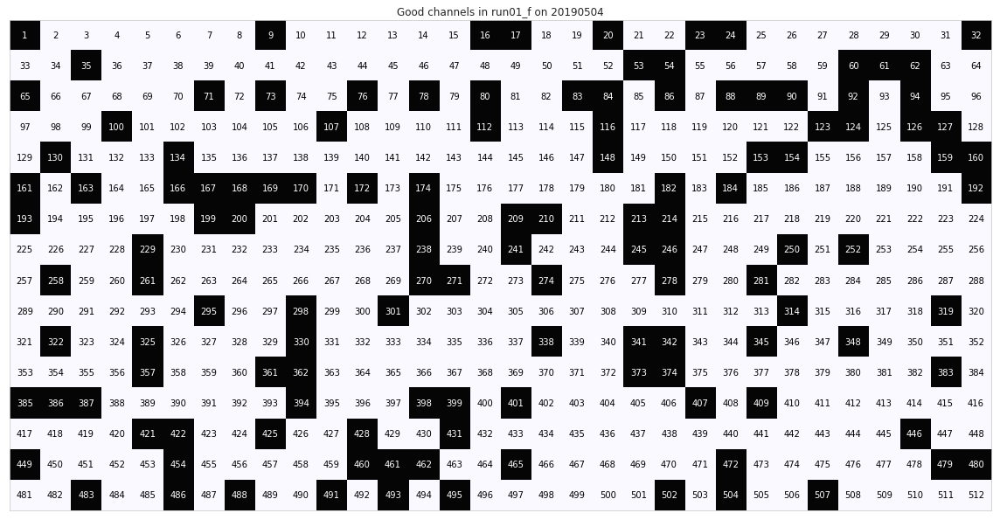

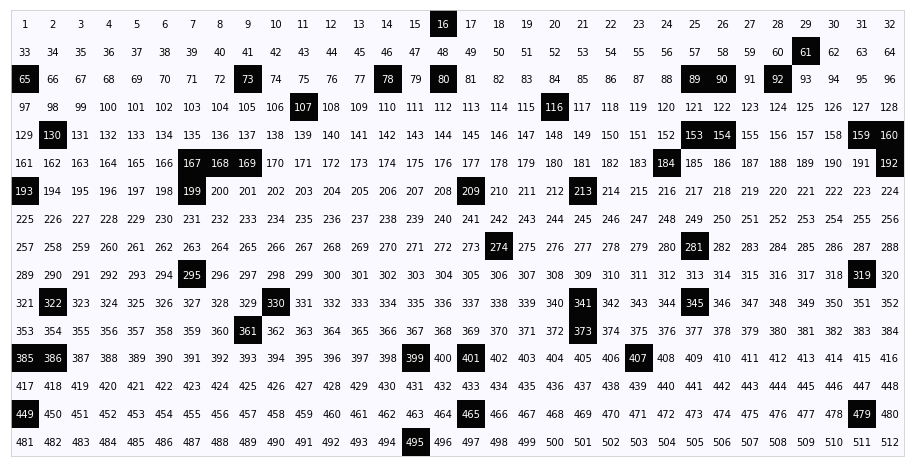

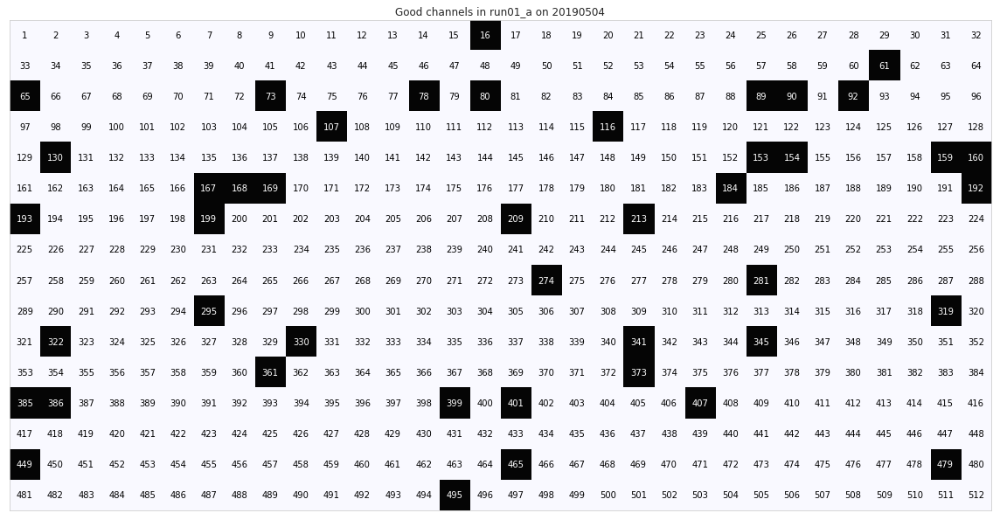

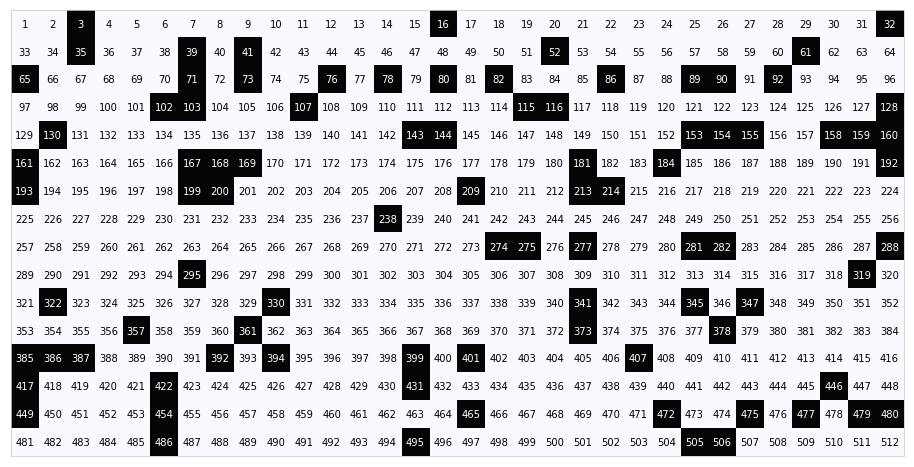

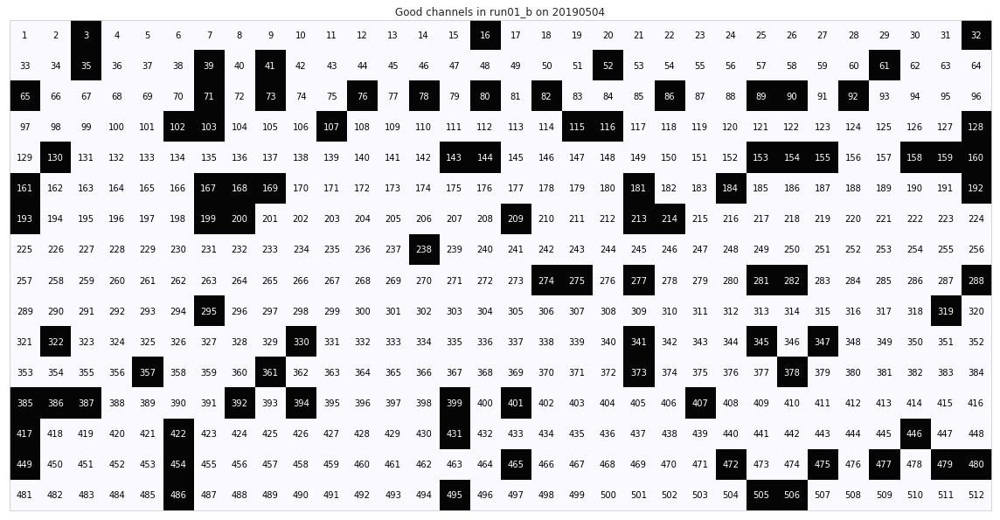

...

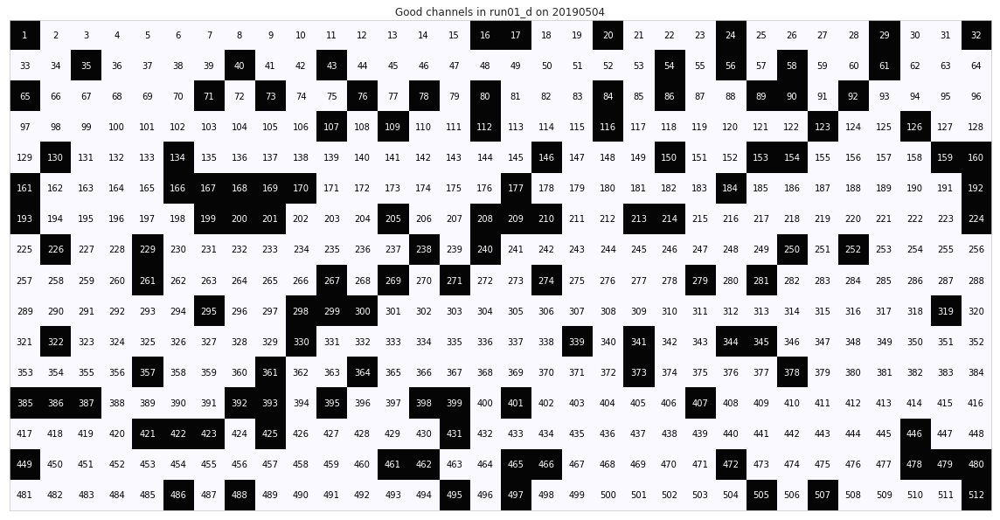

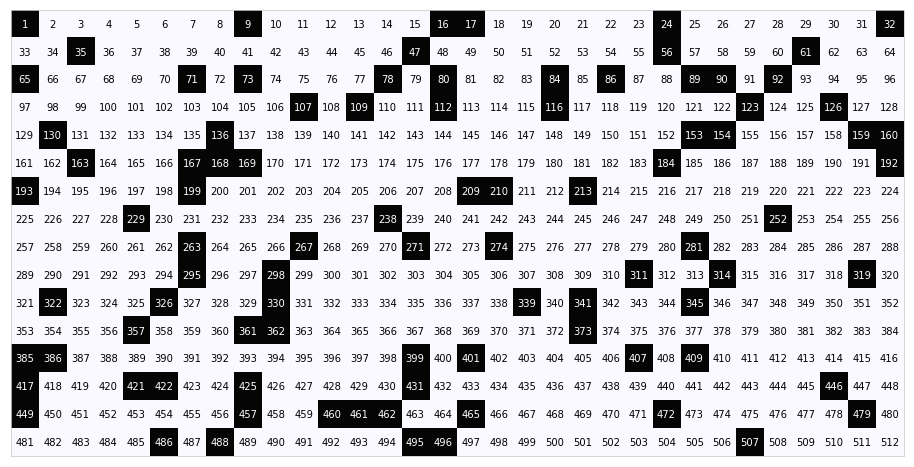

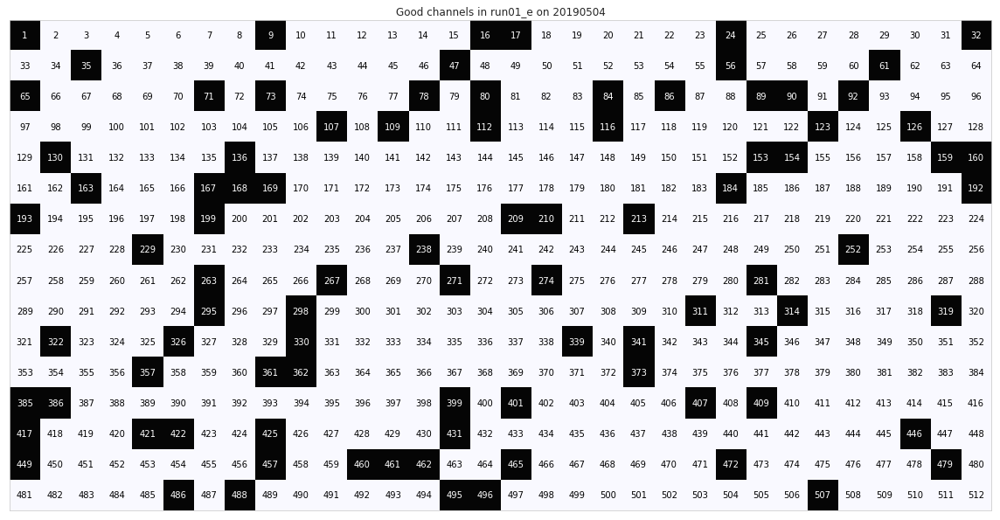

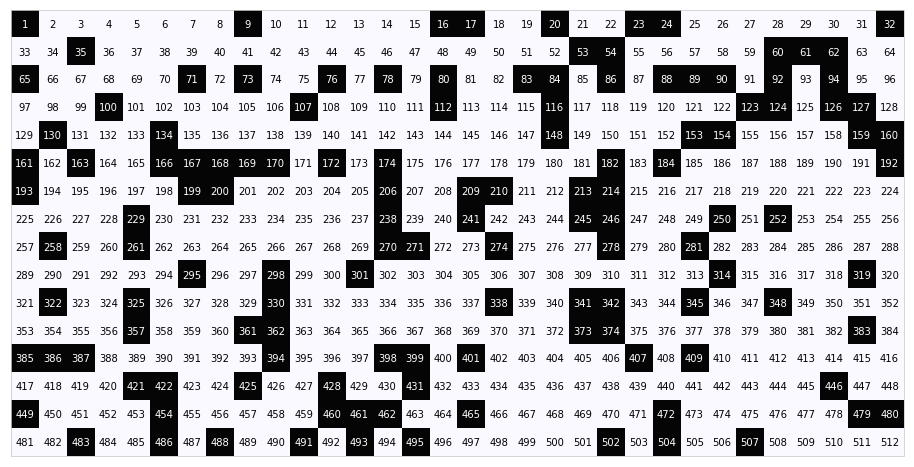

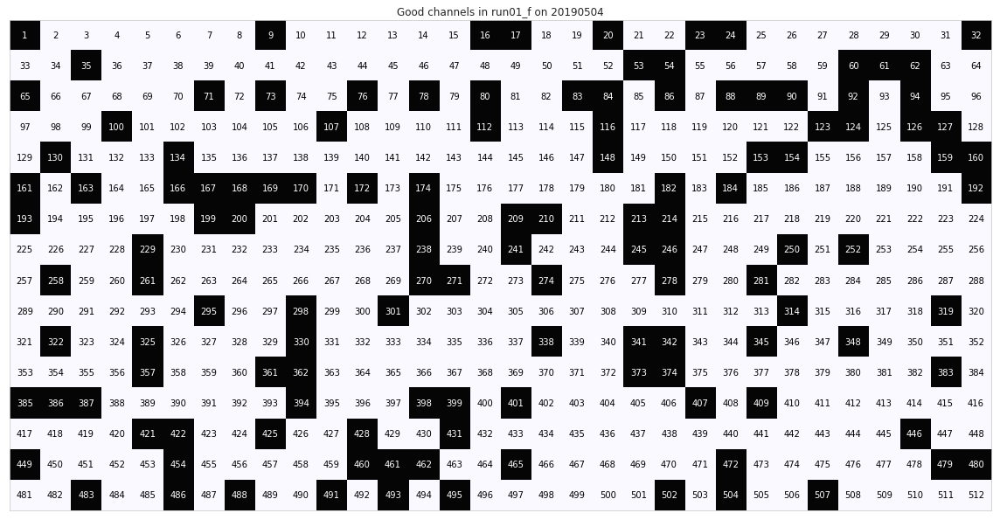

In [7]:
signal_priors = y.get_variable("segmentation_params:signal_priors")
prior_open_pore = signal_priors.get("prior_open_pore_mean")
prior_open_pore_std = signal_priors.get("prior_open_pore_std")

from plot_utils import make_cmap
cmap = make_cmap([(0.02, 0.02, 0.02), (0.7, 0.7, 0.7), (0.98, 0.98, 1)])

try:
    os.makedirs("../plots/%s/qc/" % date)
except:
    pass

# Redetermine good channels if needed
for i, (run, name) in enumerate(fast5_fnames.iteritems()):
    f5_fname = fast5_dir + "/" + fast5_prefix + name
    print f5_fname
    print "Finding good channels in %s." % (run)
    channel_grid, good_channels = judge_channels(f5_fname, expected_open_pore=None, plot_grid=True)
    print "Writing good channels to yaml file."
    good_channels = [int(c) for c in good_channels]
    y.write_variable("fast5:good_channels:%s" % (run), good_channels)
    print "Plotting channel status."
    fig, _ = plot_channel_grid(channel_grid, cmap,
                               title="Good channels in %s on %s" % (run, date),
                               cbar_minmax=(0, None))
    fig.tight_layout()
    fig.savefig("../plots/%s/qc/%s_%s_good_channels.png" %
                            (date, date, run))
    display(fig)

In [8]:
y = YAMLAssistant(config_file)

# Find peptides

In [9]:
open_pore_prior = y.get_variable("segmentation_params:signal_priors:prior_open_pore_mean")
open_pore_prior_std = y.get_variable("segmentation_params:signal_priors:prior_open_pore_std")
good_channels = y.get_variable("fast5:good_channels")

In [10]:
fast5_fnames_full = fast5_fnames.copy()
for run, fname in fast5_fnames_full.iteritems():
    fast5_fnames_full[run] = os.path.join(fast5_dir, fast5_prefix + fname)
save_location = y.get_variable("segmentation_params:out_prefix")
min_duration_obs = y.get_variable("segmentation_params:min_duration_obs")
signal_threshold = y.get_variable("segmentation_params:signal_threshold")
voltage_threshold = -180.

Saves capture metadata in `.pkl` files.

In [11]:
pepseg.parallel_find_peptides(
    fast5_fnames_full, good_channels,
    open_pore_prior, open_pore_prior_std,
    0.7, voltage_threshold, min_duration_obs,
    save_location=save_location,
    save_prefix="%s_segmented_peptides" % date,
    voltage_change_delay=3,
    n_workers=30) 

Reading in signals for run: run01_a


[########################################] | 100% Completed |  1min 27.2s


Reading in signals for run: run01_b


[########################################] | 100% Completed |  2min 40.8s


Reading in signals for run: run01_c


[########################################] | 100% Completed | 53.5s


Reading in signals for run: run01_d


[########################################] | 100% Completed |  2min 21.5s


Reading in signals for run: run01_e


[########################################] | 100% Completed |  1min  2.1s


Reading in signals for run: run01_f


[########################################] | 100% Completed |  2min 15.7s


Saves raw capture data in `.npy` files.

In [12]:
pepseg.extract_raw_data(fast5_fnames_full, df_location=save_location,
                        df_prefix="%s_segmented_peptides" % date,
                        save_location=save_location,
                        save_prefix="%s_segmented_peptides_raw_data" % date,
                        open_pore_prior=open_pore_prior,
                        open_pore_prior_stdv=open_pore_prior_std)

Saving data from run01_a
Saving data from run01_b
Saving data from run01_c
Saving data from run01_d
Saving data from run01_e
Saving data from run01_f


# Filter and Classify Peptides

Default classifier is CNN. To use Random Forest, change `NTER_cnn` to `NTER_rf`. To filter without classifying, change to `""`.

Default confidence threshold is 0.95. Saves filtered and classified capture metadata in `.csv` files.

In [19]:
filtered_fnames = pepfilter.filter_and_classify_peptides(date, fast5_fnames.keys(), "NTER_general", "NTER_cnn", 
                                                         conf_thresh=0.95)

Confidence Threshold: 0.95

Starting run chunk run01_a
/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_a.fast5
/disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_raw_data_run01_a.npy
/disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_a.pkl
12900
13200
13900
33600
% did not pass filter (out of total captures): 74.8366013072
% passed filter but not classifier (out of total captures): 4.90196078431
Saving to /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class04_run01_a.csv
Starting run chunk run01_b
/disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_b.fast5
/disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_raw_data_run01_b.npy
/disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_b.pkl
100
1500
2300
4400
5100
6700
7400
7600
83

200
4400
10700
13200
14600
14900
15000
15200
15400
17900
18600
20100
20200
20500
20600
20700
20900
21300
21400
23100
23300
23400
24800
25300
29100
29400
30200
30400
30500
32200
32900
37500
38400
38900
40200
42700
42800
48000
54400
55200
55300
55500
57100
59200
59300
59400
60200
60900
61700
62600
65600
66100
66700
71500
71700
72100
72800
73100
75000
% did not pass filter (out of total captures): 45.6663408276
% passed filter but not classifier (out of total captures): 35.9563375692
Saving to /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class00_run01_e.csv
Saving to /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class01_run01_e.csv
Saving to /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class02_run01_e.csv
Saving to /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class03_run01_e.csv
Saving to /disk1/pore_data/segmented/peptides/2019

# Quantify Peptides

Quantify peptides via two methods: time between captures (obs) and capture frequency (# of reads/pore/min). Set `time_interval` to an integer in minutes to break run into time segments when quantifying (e.g. `time_interval=5` will make a quantification every 5 min).

Saves average times/frequencies for each filtered file as a dictionary in a `.json` file.

## Time Between Captures

In [22]:
time_quantified_dict = {}
for fname in filtered_fnames:
    time = pepquant.get_time_between_captures(fname, time_interval=None)
    print "Time Between Captures:"
    print time
    time_quantified_dict[fname] = time
    print "Estimated Conc in uM:"
    print [pepquant.NTER_time_fit(x) for x in time]
    print
    print

Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class04_run01_a.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_a.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_a.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 468

Number of Captures: [1]

Time Between Captures:
[2018440.0]
Estimated Conc in uM:
[0.008339083038647502]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class00_run01_b.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_b.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_b.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Nu

Number of Channels: 443

Number of Captures: [27]

Time Between Captures:
[471585.037037037]
Estimated Conc in uM:
[0.03792143691249515]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class04_run01_c.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_c.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_c.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 443

Number of Captures: [234]

Time Between Captures:
[522253.4316239316]
Estimated Conc in uM:
[0.03409704788599316]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class05_run01_c.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_c.fast5
Capture File: /disk1/pore_data/segme

Number of Channels: 421

Number of Captures: [7]

Time Between Captures:
[306298.4285714286]
Estimated Conc in uM:
[0.059444133660249955]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class01_run01_e.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_e.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_e.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 421

Number of Captures: [5]

Time Between Captures:
[399198.2]
Estimated Conc in uM:
[0.04510988339268051]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class02_run01_e.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_e.fast5
Capture File: /disk1/pore_data/segmented/pepti

Number of Channels: 383

Number of Captures: [166]

Time Between Captures:
[122672.06024096385]
Estimated Conc in uM:
[0.15419362117327612]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class07_run01_f.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_f.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_f.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 383

Number of Captures: [14]

Time Between Captures:
[110811.35714285714]
Estimated Conc in uM:
[0.1714225103948366]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class08_run01_f.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_f.fast5
Capture File: /disk1/pore_data/seg

In [23]:
json.dump(time_quantified_dict, 
          file(os.path.join(os.path.dirname(os.getcwd()),"peptide_conc/experiment_%s_%s_time.json" % (date, flowcell)), "w"))

## Capture Frequency

In [24]:
freq_quantified_dict = {}
for fname in filtered_fnames:
    freq = pepquant.get_capture_freq(fname, time_interval=None)
    print "Capture Frequency:"
    print freq
    freq_quantified_dict[fname] = freq
    print "Estimated Conc in uM:"
    print [pepquant.NTER_freq_fit(x) for x in freq]
    print
    print

Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class04_run01_a.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_a.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_a.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 468

Capture Frequency:
[0.00035612535612535614]
Estimated Conc in uM:
[2.4906537533595433e-07]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class00_run01_b.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_b.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_b.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channe

Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class04_run01_c.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_c.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_c.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 443

Capture Frequency:
[0.10564334085778782]
Estimated Conc in uM:
[0.013038502400514322]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class05_run01_c.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_c.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_c.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 4

Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class01_run01_e.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_e.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_e.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 421

Capture Frequency:
[0.0023752969121140144]
Estimated Conc in uM:
[9.3186310939591e-06]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class02_run01_e.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_e.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_e.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 

Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class07_run01_f.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_f.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_f.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channels: 383

Capture Frequency:
[0.0030461270670147957]
Estimated Conc in uM:
[1.4981517502354987e-05]


Filter File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_filtered_cnn_class08_run01_f.csv
Raw File: /disk1/pore_data/MinION_raw_data_20190504/DESKTOP_CHF4GRO_20190504_FAK67809_MN25769_sequencing_run_05_04_19_run01_f.fast5
Capture File: /disk1/pore_data/segmented/peptides/20190504/20190504_segmented_peptides_run01_f.pkl
Config File: /ssd1/home/kz9/peptide-signatures/configs/segment_20190504_run01.yml

Number of Channel

In [25]:
json.dump(freq_quantified_dict, 
          file(os.path.join(os.path.dirname(os.getcwd()),"peptide_conc/experiment_%s_%s_freq.json" % (date, flowcell)), "w"))